# **Memes Classification **

### 1.1 Problem Description


Can we build a model which can identify memes images and real images?

In [ ]:
import matplotlib.pyplot as plt
import imutils
import cv2
from PIL import Image
import PIL

### 2.3 Data Cleaning.

There are so many images extension available in the market. Something like JPG, JPEG, PNG, SVG, GIF, PSD , RAW and so on.

We decide to focus on JPG and JPEG images. We try to convert images all images to JPG format.

In [3]:
import imutils
import cv2
from PIL import Image
import PIL

import os
from os import makedirs
from os.path import exists, join
import shutil

import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import random
import pickle
import time

from keras.applications import vgg16,vgg19, inception_v3, resnet50, mobilenet

from keras.applications.vgg16 import VGG16, preprocess_input
from keras.models import Sequential
from keras import layers
from keras.preprocessing import image

from keras.applications.imagenet_utils import preprocess_input,decode_predictions

from joblib import load, dump

from keras.utils import np_utils

from keras.layers import Dense, Activation, Flatten,Dropout
from keras.layers import merge, Input
from keras.models import Model
from keras.utils import np_utils
from sklearn.utils import shuffle
from keras.models import load_model

from keras.optimizers import Adam,Adadelta,Nadam,RMSprop,Adamax

from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
from keras.layers import merge, Input
import tensorflow as tf

Using TensorFlow backend.


In [ ]:
from keras.callbacks import TensorBoard,ModelCheckpoint
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [6]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir("/content/drive/My Drive/Memes Detection")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##### 1. Remove .png, svg, gif files

In [ ]:


DATADIR = '/content/drive/My Drive/Memes Detection/raw data'
memes_folder = '/content/drive/My Drive/Memes Detection/raw data/memes'
no_memes_folder = '/content/drive/My Drive/Memes Detection/raw data/not_memes'

redudant_memes = '/content/drive/My Drive/Memes Detection/redudant files/memes'
redudant_no_memes = '/content/drive/My Drive/Memes Detection/redudant files/no_memes'

IMG_SIZE =224

def removeRedundantFiles(path,redudant_file):
  '''
  This function is used to filter out file extension.
  '''
    
    files= []

    # r=root, d=directories, f = files
    for r, d, f in os.walk(path):
        for file in f:
            full_path = os.path.join(r, file)
            
            if file.endswith(".jpg") or file.endswith(".jpeg") :
                files.append(full_path)
            elif file.endswith(".png"):
                try:
                    im = Image.open(full_path)
                    rgb_im = im.convert('RGB')
                    rgb_im.save(full_path+'.jpg')
                    if os.path.isfile(full_path):
                        os.remove(full_path)
                except:
                    shutil.move(full_path, redudant_file)
                
            else:
                shutil.move(full_path, redudant_file)
                
    return files

### Let's Visualise data

## **`Sample Memes Images`**

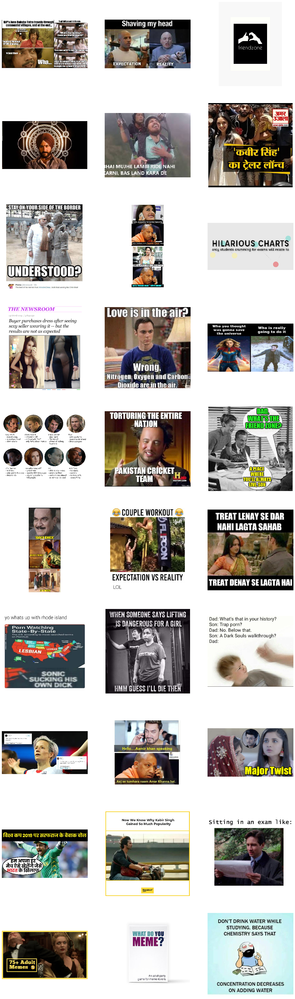

In [ ]:
rows = 10
path= '/content/drive/My Drive/Meme Detection/data/test/memes'

os.chdir(path)
files=os.listdir(path)
files=files[:30]


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    plt.imshow(img)

  except Exception as e:  # in the interest in keeping the output clean...
    pass

## **`Sample Not-Memes Images/ Real Images`**

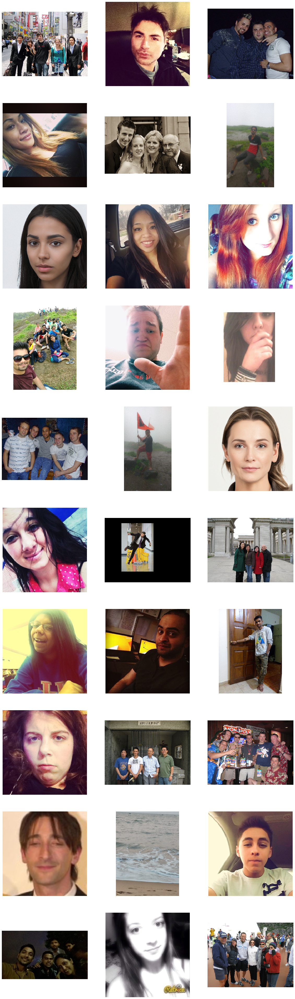

In [ ]:
rows = 10
path= '/content/drive/My Drive/Meme Detection/data/test/not_memes'

os.chdir(path)
files=os.listdir(path)
files=files[:30]


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    plt.imshow(img)

  except Exception as e:  # in the interest in keeping the output clean...
    pass

  


## 2.3 Train, Validation and Test sets

Now after data cleaning next step is to divide whole dataset into Train, Validation and Test sets.

<br>

We are splitting data into 70% Train, 15% Validate and 15% Test Set.

In [ ]:
## split data
split_1 = int(0.7 * len(meme_files_list))
split_2 = int(0.85 * len(meme_files_list))
train_filenames = meme_files_list[:split_1]
validate_filenames = meme_files_list[split_1:split_2]
test_filenames = meme_files_list[split_2:]


n_split_1 = int(0.7 * len(not_meme_files_list))
n_split_2 = int(0.85 * len(not_meme_files_list))
n_train_filenames = not_meme_files_list[:n_split_1]
n_dev_filenames = not_meme_files_list[n_split_1:n_split_2]
n_test_filenames = not_meme_files_list[n_split_2:]

In [ ]:
len(train_filenames), len(validate_filenames),len(test_filenames)

(7772, 1666, 1666)

In [ ]:
len(n_train_filenames), len(n_dev_filenames),len(n_test_filenames)

(7373, 1580, 1581)

In [ ]:
train_dir = "/content/drive/My Drive/Memes Detection/data/train"
validate_dir = "/content/drive/My Drive/Memes Detection/data/validate"
test_dir =  "/content/drive/My Drive/Memes Detection/data/test"

## Train data directory
meme_train_dir= train_dir+"/memes"
not_meme_train_dir= train_dir+"/not_memes"

if not os.path.exists(meme_train_dir):
    os.makedirs(meme_train_dir)
if not os.path.exists(not_meme_train_dir):
    os.makedirs(not_meme_train_dir)

## validation data directory
meme_validate_dir= validate_dir+"/memes"
not_meme_validate_dir= validate_dir+"/not_memes"

if not os.path.exists(meme_validate_dir):
    os.makedirs(meme_validate_dir)
if not os.path.exists(not_meme_validate_dir):
    os.makedirs(not_meme_validate_dir)

## test data directory
meme_test_dir= test_dir+"/memes"
not_meme_test_dir= test_dir+"/not_memes"

if not os.path.exists(meme_test_dir):
    os.makedirs(meme_test_dir)
if not os.path.exists(not_meme_test_dir):
    os.makedirs(not_meme_test_dir)

In [ ]:
def split_data(file_list, dest_path):
    
    for file in file_list:
        shutil.copy(file,dest_path )

#### Split Data

In [ ]:
split_data(train_filenames, meme_train_dir)
split_data(n_train_filenames, not_meme_train_dir)

split_data(validate_filenames, meme_validate_dir)
split_data(n_dev_filenames, not_meme_validate_dir)

split_data(test_filenames, meme_test_dir)
split_data(n_test_filenames, not_meme_test_dir)

### 2.4 Data Preprocessing

Convert Images to array using open-cv and keras preprocessing lib.

In [ ]:
IMG_SIZE =224

def lableling_data(dir_path):


  '''This Method is used to convert images to array using Keras preprocessing library.
    Also it will generate y output.

    Y = 0 (Not Meme)
    Y = 1 (Meme)'''

    X = []
    y = []
    i = 1
    
    # for loop is find all files in dir_path
    for path in (sorted(os.listdir(dir_path))):
        if not path.startswith('.'):
            for file in tqdm(os.listdir(dir_path + path)):
                if not file.startswith('.'):
                    
                    try:
                  
                        img = image.load_img(dir_path + path + '/' + file, target_size=(IMG_SIZE, IMG_SIZE))
                        x = image.img_to_array(img)
                        x = np.expand_dims(x, axis=0)
                        x = preprocess_input(x)
                        X.append(x)
                        y.append(i)
                    except Exception as e:  # in the interest in keeping the output clean...
                        pass
            i -= 1
    X = np.array(X)
    y = np.array(y)
    return X, y

In [ ]:
X_train, y_train = lableling_data(train_dir)

  2%|▏         | 119/7772 [00:00<00:56, 135.23it/s]/home/pranay/anaconda3/lib/python3.7/site-packages/PIL/Image.py:2655: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)
 33%|███▎      | 2531/7772 [00:16<00:28, 181.88it/s]/home/pranay/anaconda3/lib/python3.7/site-packages/PIL/Image.py:952: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  ' expressed in bytes should be converted ' +
  8%|▊         | 648/7650 [00:07<01:14, 93.49it/s] /home/pranay/anaconda3/lib/python3.7/site-packages/PIL/TiffImagePlugin.py:771: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))
100%|██████████| 7650/7650 [01:22<00:00, 92.32it/s] 


In [ ]:
X_val, y_val = label_data_n_reshape(validate_dir)

100%|██████████| 1666/1666 [00:11<00:00, 142.78it/s]


In [ ]:
X_test, y_test = label_data_n_reshape(test_dir)

  1%|          | 14/1666 [00:00<00:12, 129.51it/s]/home/pranay/anaconda3/lib/python3.7/site-packages/PIL/Image.py:2655: UserWarning: image file could not be identified because WEBP support not installed
  warnings.warn(message)
100%|██████████| 1666/1666 [00:12<00:00, 135.25it/s]


### 2.5 Persist Data

Store data to local disk so that we can use it in future.

In [ ]:
dump(X_train, 'pkl_files/X_train.pkl')
dump(y_train, 'pkl_files/y_train.pkl')

dump(X_val, 'pkl_files/X_val.pkl')
dump(y_val, 'pkl_files/y_val.pkl')

dump(X_test, 'pkl_files/X_test.pkl')
dump(y_test, 'pkl_files/y_test.pkl')

In [ ]:
import pandas as pd
import seaborn as sns


def plotErrorGraph(history, ep=30):

    ''' 
    This function is used to plot Train Error Vs Validation Error graph
    '''
    plt.figure(figsize=(12, 8))

    loss = history.history['loss']                          # Loss on the training data
    val_loss = history.history['val_loss']                  # Loss on the validation data
    epochs = range(1, ep+1)

    plt.plot(epochs, loss, 'ro-', label='Training Loss')
    plt.plot(epochs, val_loss, 'go-', label = 'Validation Loss')
    plt.legend()

In [ ]:
def data():
    X_train = load('pkl_files/X_train.pkl')
    y_train = load('pkl_files/y_train.pkl')
    X_val = load('pkl_files/X_val')
    y_val = load('pkl_files/y_val')
    X_test = load('pkl_files/X_test')
    y_test = load('pkl_files/y_test')

    return X_train, y_train, X_val, y_val, X_test,y_test

X_train, y_train, X_val, y_val, X_test,y_test  = data()

In [ ]:
print('Train X--', X_train.shape,'y --', y_train.shape  )
print('Test X--', X_test.shape,'y --', y_test.shape  )
print('Validation X--', X_val.shape,'y --', y_val.shape  )

Train X-- (15404, 1, 224, 224, 3) y -- (15404,)
Test X-- (3267, 1, 224, 224, 3) y -- (3267,)
Validation X-- (3260, 1, 224, 224, 3) y -- (3260,)


We can see that there is almost 15k Training set, 3.2k Test set and 3.2k validation set.

But we need to convert it into 5 dimension array.

In [ ]:
def reshape_array(X):

  '''  
  reshape input data. Convert to 4 dimensions [size, width, height,  pixel]
  '''
  X=np.rollaxis(X,1,0)

  X=X[0]
  X.shape
  return X

In [ ]:
X_val = reshape_array(X_val)
X_val.shape

(3260, 224, 224, 3)

In [ ]:
X_train = reshape_array(X_train)
X_train.shape

(15404, 224, 224, 3)

In [ ]:
X_test = reshape_array(X_test)
X_test.shape

(3267, 224, 224, 3)

Now we are ready to with data. We are ready to perform modeling.

# **3.Model** 

#### **VGG16**


In [ ]:
image_input = Input(shape=(224, 224, 3))

vgg_model = VGG16(input_tensor=image_input, include_top=False,weights='imagenet')

output_classes = 1

model = Sequential()
model.add(vgg_model)
model.add(layers.Flatten())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()





58892288/58889256 [==============================] - 1s 0us/step







Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.
Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Model)                (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten_1 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 25089     
Total params: 14,739,777
Trainable params: 25,089
Non-trainable params: 14,714,688
_________________________________________________________________


In [ ]:
# compile model    
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          epochs=13)




Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 15404 samples, validate on 3260 samples
Epoch 1/13
15404/15404 [==============================] - 183s 12ms/step - loss: 0.6912 - acc: 0.9479 - val_loss: 0.5087 - val_acc: 0.9660
Epoch 2/13
15404/15404 [==============================] - 173s 11ms/step - loss: 0.5604 - acc: 0.9612 - val_loss: 0.5139 - val_acc: 0.9653
Epoch 3/13
15404/15404 [==============================] - 172s 11ms/step - loss: 0.5063 - acc: 0.9649 - val_loss: 0.4612 - val_acc: 0.9693
Epoch 4/13
15404/15404 [==============================] - 173s 11ms/step - loss: 0.4887 - acc: 0.9676 - val_loss: 0.4925 - val_acc: 0.9669
Epoch 5/13
15404/15404 [==============================] - 173s 11ms/step - loss: 0.4931 - acc: 0.9672 - val_loss: 0.5254 - val_acc: 0.9656
Epoch 6/13
15404/15404 [==============================] - 173s 11ms/step - loss: 0.4596 - acc: 0.9697 - val_loss: 0.5205 - val_acc: 0.9663
Epoch 7/13
15404/15

IndexError: ignored

In [ ]:
score = model.evaluate(X_test, y_test)
score

3267/3267 [==============================] - 31s 10ms/step


[0.5482314267709486, 0.9651056014692379]

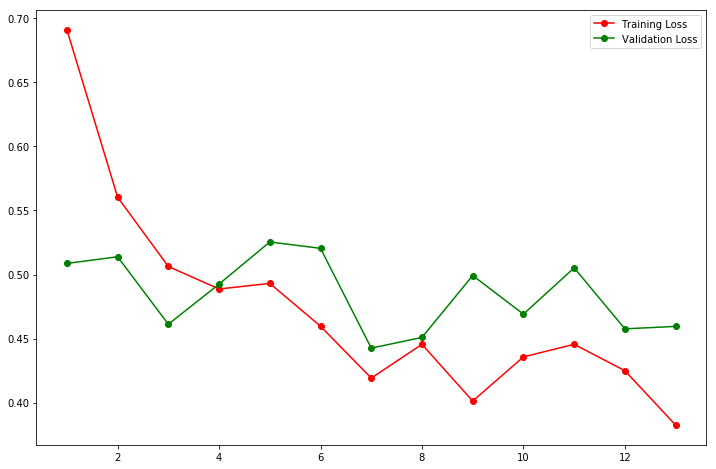

In [ ]:
plotErrorGraph(history,13)

- We can observe 0.52 Loss.
- We can observe 96.51% Accuracy.
- Model is doing well, let's try VGG19

### **VGG19**

In [ ]:
image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

# vgg_model = VGG16(input_tensor=image_input, include_top=False,weights='imagenet')


output_classes = 1

model = Sequential()
model.add(vgg_model)
model.add(layers.Flatten())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()

# compile model    
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          epochs=13)


80142336/80134624 [==============================] - 1s 0us/step
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_4 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_4 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________
Train on 15404 samples, validate on 3260 samples
Epoch 1/13
15404/15404 [==============================] - 211s 14ms/step - loss: 0.6653 - acc: 0.9492 - val_loss: 0.5776 

In [ ]:
score = model.evaluate(X_test, y_test)
score

3267/3267 [==============================] - 36s 11ms/step


[0.5170424275384069, 0.9666360575451485]

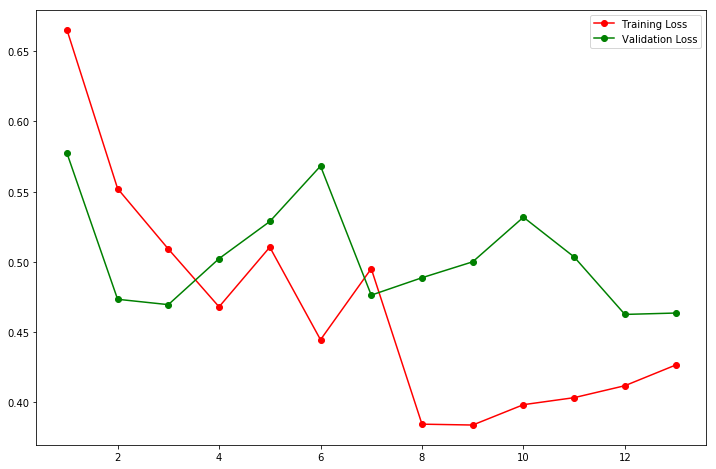

In [ ]:
plotErrorGraph(history,13)

- Vgg19 is not far from Vgg16 model performance. Lets see Inception model

### Inception Model

In [ ]:
image_input = Input(shape=(224, 224, 3))

inc_model =inception_v3.InceptionV3(input_tensor=image_input, include_top=False,weights='imagenet')

output_classes = 1

model = Sequential()
model.add(inc_model)
model.add(layers.Flatten())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()

# compile model    
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          epochs=13)


Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Model)         (None, 5, 5, 2048)        21802784  
_________________________________________________________________
flatten_3 (Flatten)          (None, 51200)             0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 51200)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 51201     
Total params: 21,853,985
Trainable params: 51,201
Non-trainable params: 21,802,784
_________________________________________________________________
Train on 15404 samples, validate on 3260 samples
Epoch 1/13
15404/15404 [==============================] - 118s 8ms/step - loss: 0.3368 - acc: 0.9099 - val_loss: 8.0480 - val_acc: 0.4810
Epoch 2/13
15404/15404 [========================

In [ ]:
score = model.evaluate(X_test, y_test)
score

3267/3267 [==============================] - 20s 6ms/step


[8.032122796596939, 0.4955616773798592]

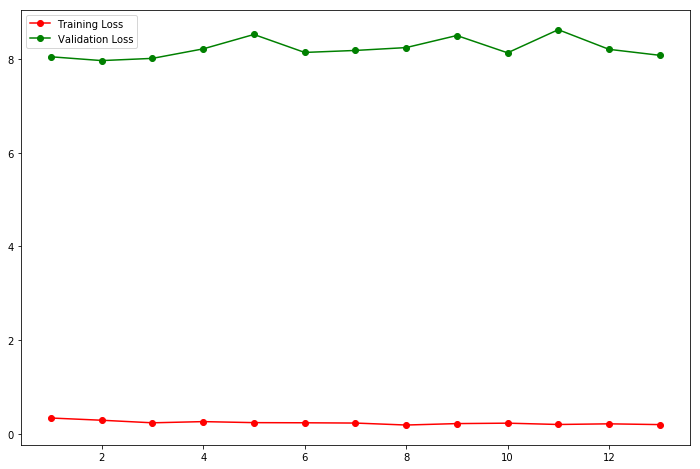

In [ ]:
plotErrorGraph(history,13)

- This terrible. It is Overfitting. Train loss is need to 0.1 and Validation loss is close to 8.5.
- Discard this option

### ResNet50

In [ ]:
image_input = Input(shape=(224, 224, 3))

resmodel =resnet50.ResNet50 (input_tensor=image_input, include_top=False,weights='imagenet')
resmodel.summary()

output_classes = 1

model = Sequential()
model.add(resmodel)
model.add(layers.Flatten())
model.add(layers.Dropout(0.2))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()

# compile model    
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          epochs=6)


/usr/local/lib/python3.6/dist-packages/keras_applications/resnet50.py:265: UserWarning: The output shape of `ResNet50(include_top=False)` has been changed since Keras 2.2.0.
  warnings.warn('The output shape of `ResNet50(include_top=False)` '


Model: "resnet50"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_8 (InputLayer)            (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_8[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 112, 112, 64) 256         conv1[0][0]                      
___________________________________________________________________________________________

In [ ]:
score = model.evaluate(X_test, y_test)
score

3267/3267 [==============================] - 29s 9ms/step


[0.859504307345145, 0.9406183042546679]

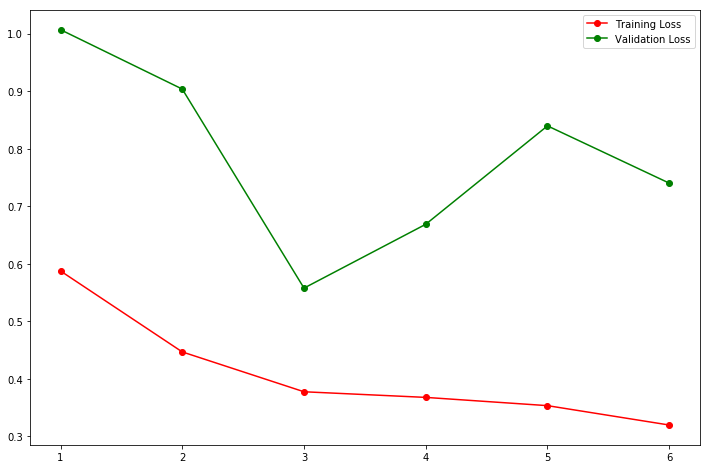

In [ ]:
plotErrorGraph(history,6)

- ResNet50 model is better than in inception but not as good as Vgg19
- Discard this option



---



Till now we have observed various models; VGG19 is working quite when so lets focus on VGG19.

### **Hyperparam Tuning on VGG19**

### 1. Let's remove top layer and add our own layers

In [ ]:
import time

dense_layers = [0, 1]
layer_sizes = [128,256,512]
conv_layers = [1, 2, 3]

image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

for dense in dense_layers:
  for node in layer_sizes:
    
    NAME = "{}-nodes-{}-dense-{}".format( node, dense, int(time.time()))
    print(NAME)

    model = Sequential()
    model.add(vgg_model)
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.2))
    model.add(Dense(node))
    for _ in range(dense):
      model.add(Dense(node))
    model.layers[0].trainable = False

    for layer in model.layers:
      print(layer, layer.trainable)
    model.add(layers.Dense(output_classes, activation='sigmoid'))
    model.summary()

    tensorboard = TensorBoard(log_dir="logs/{}".format(NAME))

    model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

    history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          callbacks= [tensorboard],
          epochs=10)
    
    print(model.metrics_names)
    score = model.evaluate(X_test, y_test)
    print(score)
    print('=='*25)



128-nodes-0-dense-1571498934
<keras.engine.training.Model object at 0x7f1623231c18> False
<keras.layers.core.Flatten object at 0x7f16231f8e80> True
<keras.layers.core.Dropout object at 0x7f16231f8780> True
<keras.layers.core.Dense object at 0x7f162324ff98> True
Model: "sequential_41"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_41 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dropout_41 (Dropout)         (None, 25088)             0         
_________________________________________________________________
dense_99 (Dense)             (None, 128)               3211392   
_________________________________________________________________
dense_100 (Dense)            (None, 1)                 

In [ ]:
%tensorboard --logdir=./logs


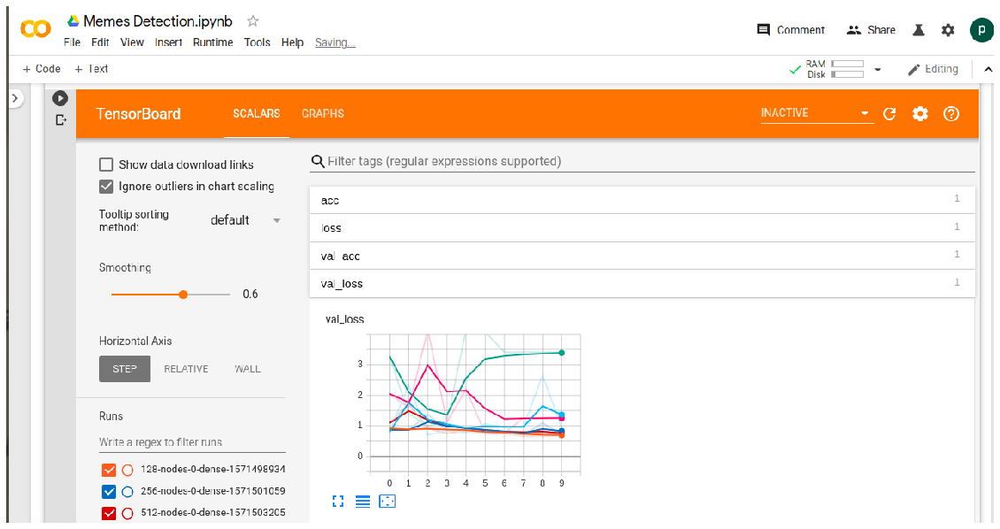

In [24]:
img = PIL.Image.open('/content/drive/My Drive/Memes Detection/result_images/layers.png')

plt.figure(figsize=(20,30))
plt.imshow(img)
plt.axis('off')
plt.show()

- After studying above graphs we can conclude adding any dense layer on top of vgg19 is bad idea. Because without any dense layer model was performing well.

<br>

Without any dense layer (test loss) = 0.5170 <br>
Without any denses layer (test accuracy)= 0.96663

<br>

With one or two dense layer has more loss. So no need to add any layer.

#### Experiment No.2 Let's try various dropout rate.

In [ ]:
import time

dropout_rate = [0.1,0.2,0.3, 0.4,0.5]
output_classes=1

image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

for dp in dropout_rate:
    
    NAME = "-Dropout rate =={}==={}".format( dp, int(time.time()))
    print(NAME)

    model = Sequential()
    model.add(vgg_model)
    model.add(layers.Flatten())
    model.add(layers.Dropout(dp))
    model.layers[0].trainable = False

    for layer in model.layers:
      print(layer, layer.trainable)
    model.add(layers.Dense(output_classes, activation='sigmoid'))
    model.summary()

    tensorboard = TensorBoard(log_dir="logs/{}".format(NAME))

    model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

    history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          callbacks= [tensorboard],
          epochs=10)
    
    print(model.metrics_names)
    score = model.evaluate(X_test, y_test)
    print(score)
    print('=='*25)



-Dropout rate ==0.1===1571764613
<keras.engine.training.Model object at 0x7fc2bb8b6898> False
<keras.layers.core.Flatten object at 0x7fc2bb87ce48> True
<keras.layers.core.Dropout object at 0x7fc2bb87cc18> True
Model: "sequential_18"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_18 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dropout_18 (Dropout)         (None, 25088)             0         
_________________________________________________________________
dense_16 (Dense)             (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________


Instructions for updat

In [ ]:
%tensorboard --logdir=./logs

Reusing TensorBoard on port 6006 (pid 1624), started 0:11:02 ago. (Use '!kill 1624' to kill it.)

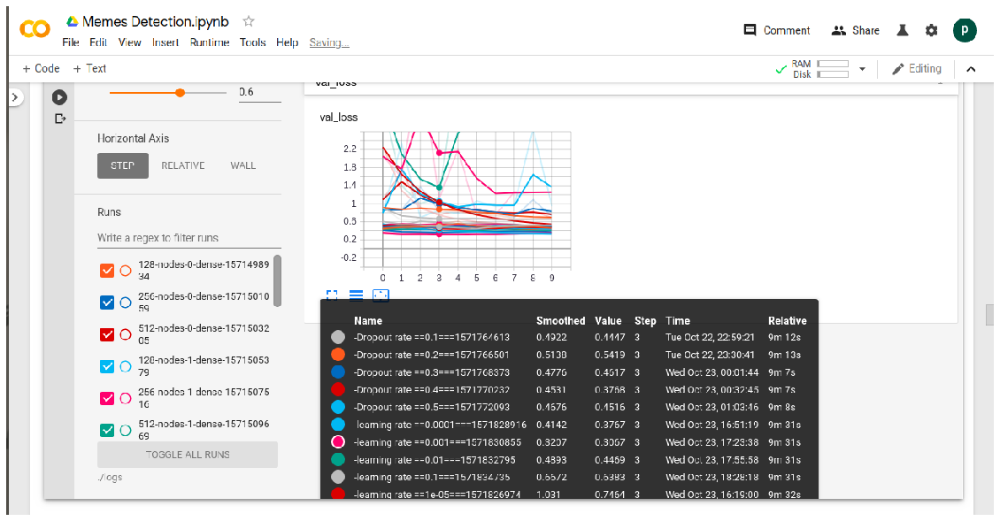

In [25]:
img = PIL.Image.open('/content/drive/My Drive/Memes Detection/result_images/learning_rate.png')

plt.figure(figsize=(20,30))
plt.imshow(img)
plt.axis('off')
plt.show()

- After visualising graphs, we can conclude that dropout rate = 0.5 is best for our model.

### Experiment 3. Choose best optimizer.

In [ ]:
import time
from keras.optimizers import Adam,Adadelta,Nadam,RMSprop,Adamax

optimizers = ['adam','adadelta','nadam','rmsprop','adamax']

output_classes=1

image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

for opt in optimizers:
    
    NAME = "-optimizers =={}==={}".format( opt, int(time.time()))
    print(NAME)

    model = Sequential()
    model.add(vgg_model)
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.5))
    model.layers[0].trainable = False

    for layer in model.layers:
      print(layer, layer.trainable)
    model.add(layers.Dense(output_classes, activation='sigmoid'))
    model.summary()

    tensorboard = TensorBoard(log_dir="logs/{}".format(NAME))

    model.compile(loss='binary_crossentropy',
              optimizer=opt,
              metrics=['accuracy'])

    history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          callbacks= [tensorboard],
          epochs=10)
    
    print(model.metrics_names)
    score = model.evaluate(X_test, y_test)
    print(score)
    print('=='*25)



-optimizers ==adam===1571775842
<keras.engine.training.Model object at 0x7fc2ba444eb8> False
<keras.layers.core.Flatten object at 0x7fc2ba4115c0> True
<keras.layers.core.Dropout object at 0x7fc2ba411a90> True
Model: "sequential_25"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_25 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dropout_25 (Dropout)         (None, 25088)             0         
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________
Train on 15404 samples, v

In [ ]:
%tensorboard --logdir=./logs

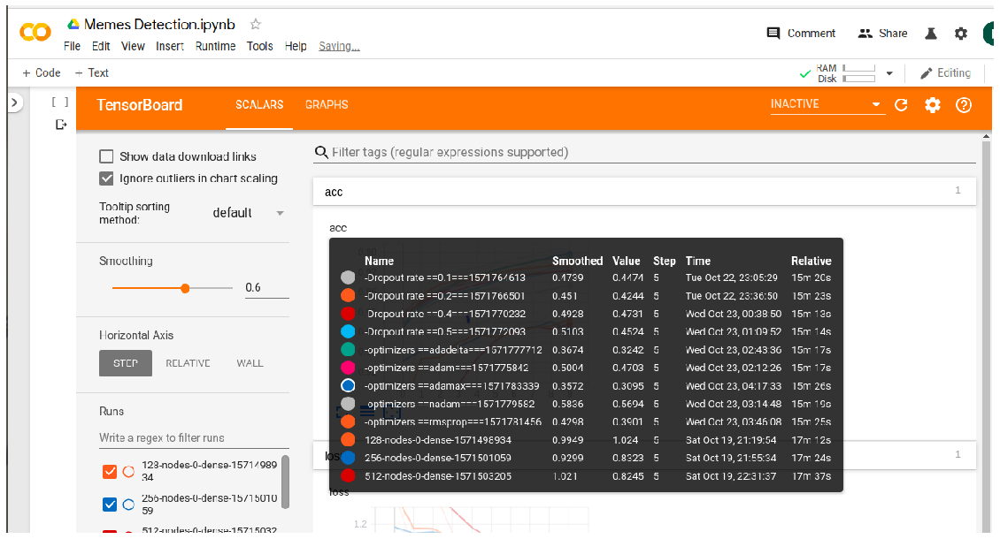

In [26]:
img = PIL.Image.open('/content/drive/My Drive/Memes Detection/result_images/optimizer.png')

plt.figure(figsize=(20,30))
plt.imshow(img)
plt.axis('off')
plt.show()

- We can clearly see that 'Adamax' has reduce minimal loss.

#### Experiment 4. Try various Learing rates.

-learning rate ==1e-05===1571826974
<keras.engine.training.Model object at 0x7f3b65143be0> False
<keras.layers.core.Flatten object at 0x7f3b6510a4e0> True
<keras.layers.core.Dropout object at 0x7f3b6510abe0> True
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________
Train on 15404 samples

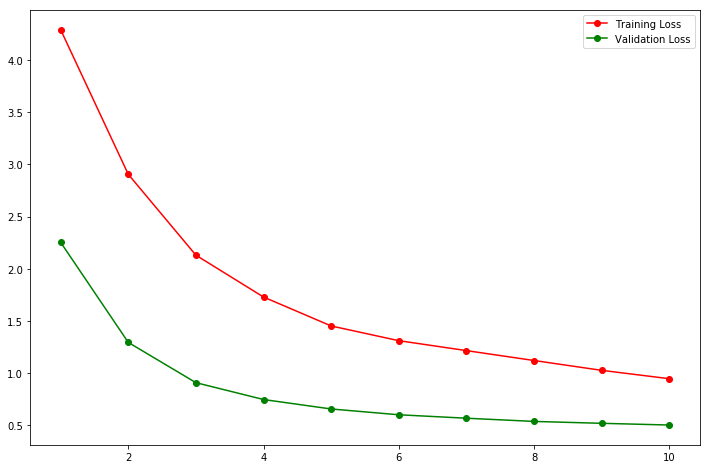

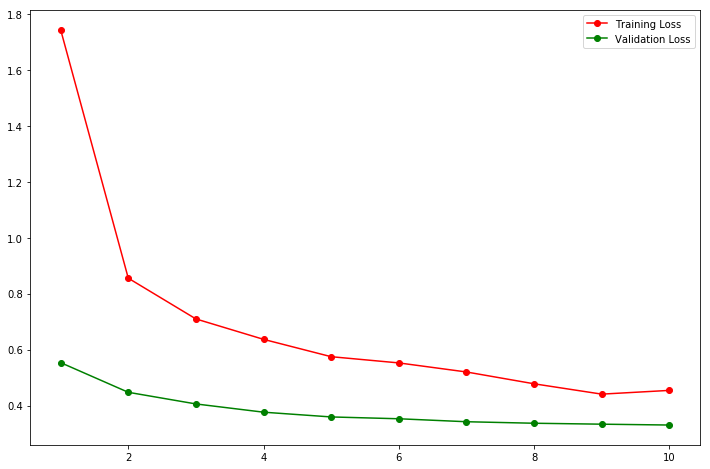

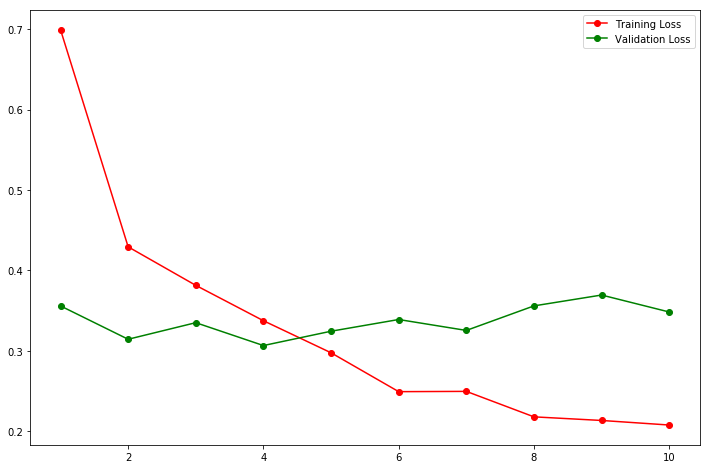

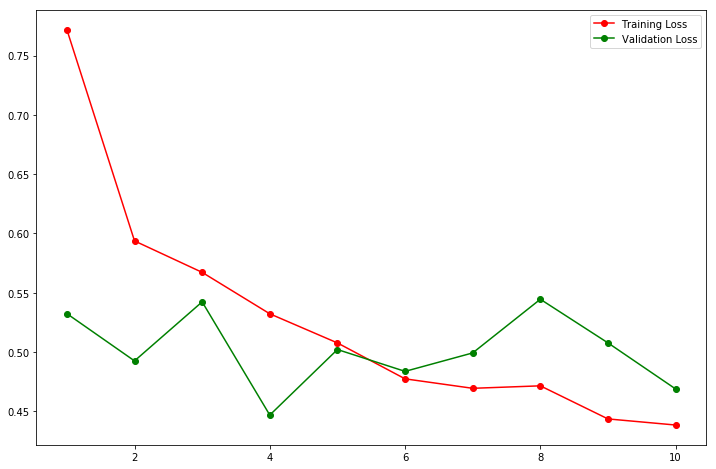

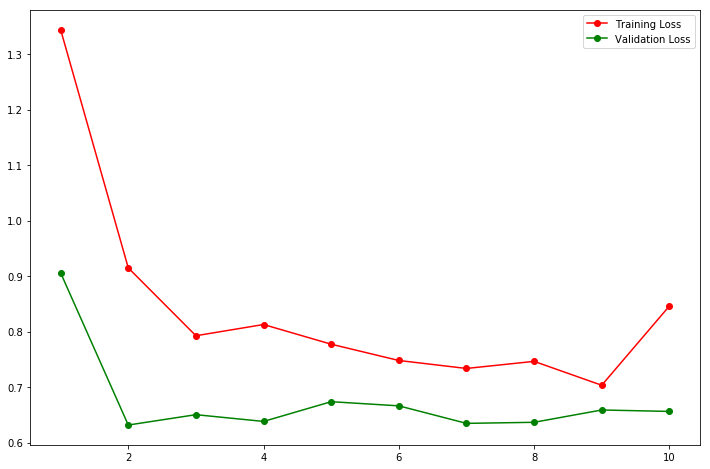

In [ ]:
import time
from keras.optimizers import Adam,Adadelta,Nadam,RMSprop,Adamax

learning_rate = [1e-5,1e-4,1e-3,1e-2,1e-1]

output_classes=1

image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

for lr in learning_rate:
    
    NAME = "-learning rate =={}==={}".format( lr, int(time.time()))
    print(NAME)

    model = Sequential()
    model.add(vgg_model)
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.5))
    model.layers[0].trainable = False

    for layer in model.layers:
      print(layer, layer.trainable)
    model.add(layers.Dense(output_classes, activation='sigmoid'))
    model.summary()

    tensorboard = TensorBoard(log_dir="logs/{}".format(NAME))

    model.compile(loss='binary_crossentropy',
              optimizer=Adamax(lr),
              metrics=['accuracy'])

    history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          callbacks= [tensorboard],
          epochs=10)
    
    print(model.metrics_names)
    score = model.evaluate(X_test, y_test)
    print(score)
    plotErrorGraph(history,10)




In [ ]:
%tensorboard --logdir=./logs

Reusing TensorBoard on port 6006 (pid 379), started 3:53:11 ago. (Use '!kill 379' to kill it.)

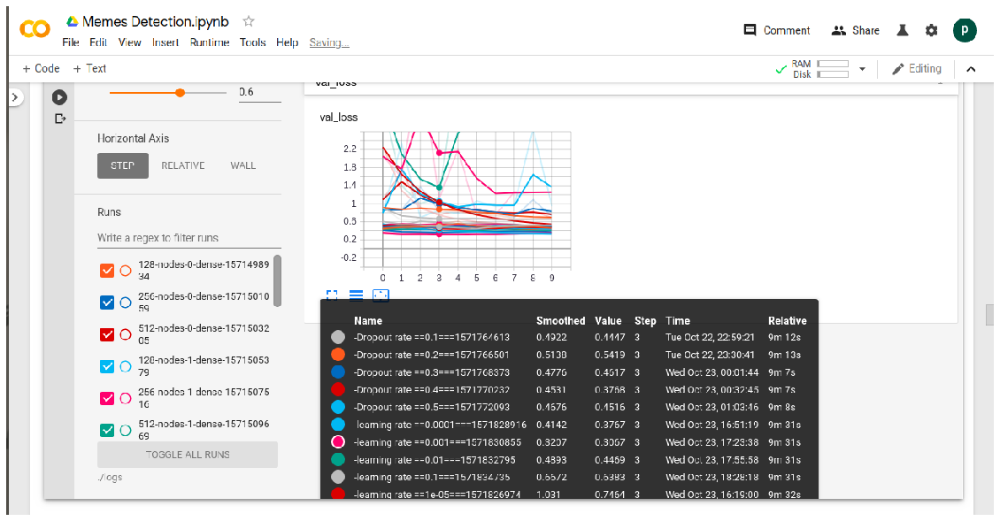

In [27]:
img = PIL.Image.open('/content/drive/My Drive/Memes Detection/result_images/learning_rate.png')

plt.figure(figsize=(20,30))
plt.imshow(img)
plt.axis('off')
plt.show()

- We can see that 0.00001 and 0.0001 are most performing learing rate.
- Lets build model with 0.0005.

We will build model with all parameter that we found

- No additional layer after TOP. (ie TOP= false)
- Dropout == 0.5
- Optimizer === Adamax
- Learning rate == 0.0005

In [ ]:
image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

output_classes = 1

model = Sequential()
model.add(vgg_model)
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()

# compile model    
model.compile(loss='binary_crossentropy',
              optimizer=Adamax(0.0005),
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=32,
          validation_data=(X_val, y_val),
          epochs=10)

print(model.metrics_names)
score = model.evaluate(X_test, y_test)
print(score)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_7 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________
Train on 15404 samples, validate on 3260 samples
Epoch 1/10
15404/15404 [==============================] - 191s 12ms/step - loss: 0.7789 - acc: 0.9226 - val_loss: 0.3772 - val_acc: 0.9589
Epoch 2/10
15404/15404 [=======================

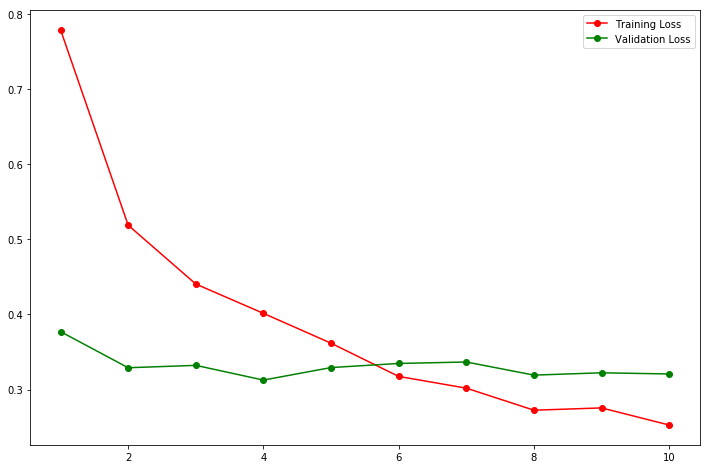

In [ ]:
plotErrorGraph(history,10)

### 5. Try various Batch size

batch size ==16===1571841278
<keras.engine.training.Model object at 0x7f3b5ac59b38> False
<keras.layers.core.Flatten object at 0x7f3b5ac25438> True
<keras.layers.core.Dropout object at 0x7f3b5ac25dd8> True
Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_10 (Flatten)         (None, 25088)             0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 25088)             0         
_________________________________________________________________
dense_10 (Dense)             (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________
Train on 15404 samples, vali

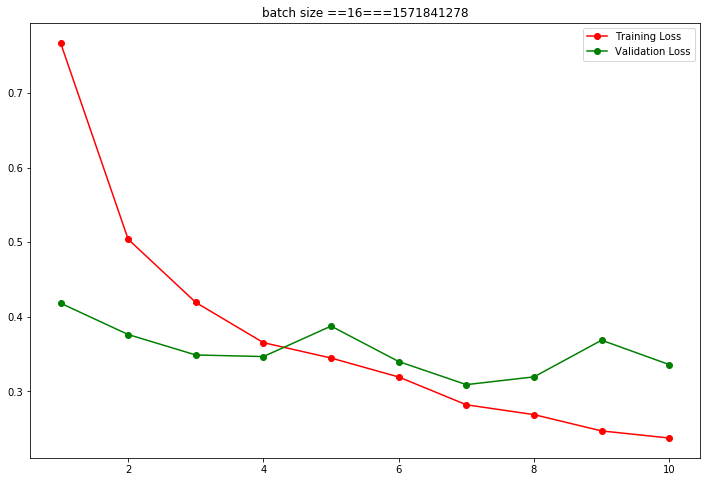

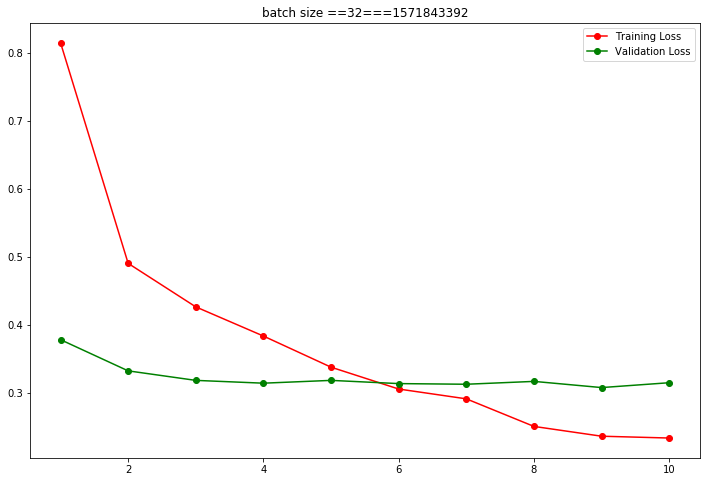

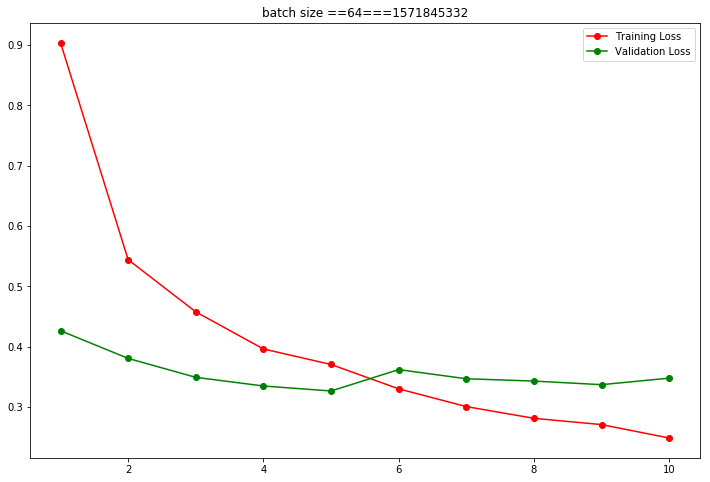

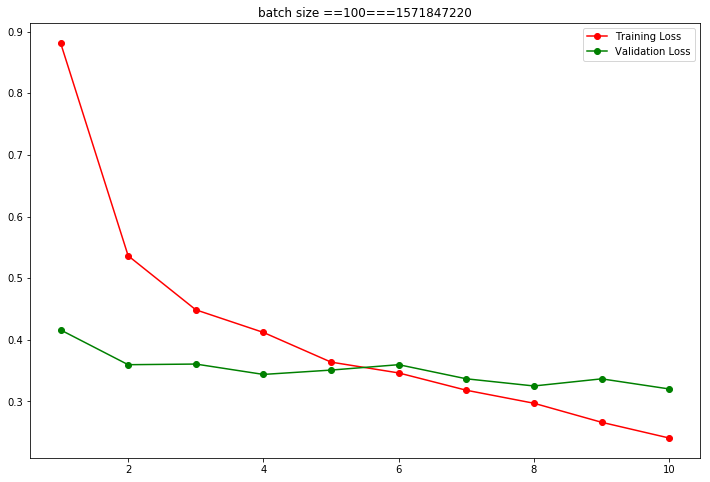

In [ ]:
import time
from keras.optimizers import Adam,Adadelta,Nadam,RMSprop,Adamax

batch_size = [16,32,64,100]

output_classes=1

image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

for batch in batch_size:
    
    NAME = "batch size =={}==={}".format( batch, int(time.time()))
    print(NAME)

    model = Sequential()
    model.add(vgg_model)
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.5))
    model.layers[0].trainable = False

    for layer in model.layers:
      print(layer, layer.trainable)
    model.add(layers.Dense(output_classes, activation='sigmoid'))
    model.summary()

    tensorboard = TensorBoard(log_dir="logs/{}".format(NAME))

    model.compile(loss='binary_crossentropy',
              optimizer=Adamax(0.0005),
              metrics=['accuracy'])

    history = model.fit(X_train,
          y_train,
          batch_size=batch,
          validation_data=(X_val, y_val),
          callbacks= [tensorboard],
          epochs=10)
    
    print(model.metrics_names)
    score = model.evaluate(X_test, y_test)
    print(score)
    plotErrorGraphTitle(history,NAME,10)






---



Let's build final resultant model.

We will build model with all parameter that we found

- No additional layer after TOP. (ie TOP= false)
- Dropout == 0.5
- Optimizer === Adamax
- Learning rate == 0.0005
- Batch size == 100

## Resultant Model

In [ ]:
image_input = Input(shape=(224, 224, 3))

vgg_model =vgg19.VGG19 (input_tensor=image_input, include_top=False,weights='imagenet')

output_classes = 1

model = Sequential()
model.add(vgg_model)
model.add(layers.Flatten())
model.add(layers.Dropout(0.5))
model.add(layers.Dense(output_classes, activation='sigmoid'))
model.layers[0].trainable = False
model.summary()

# compile model    
model.compile(loss='binary_crossentropy',
              optimizer=Adamax(0.0005),
              metrics=['accuracy'])

history = model.fit(X_train,
          y_train,
          batch_size=100,
          validation_data=(X_val, y_val),
          epochs=6)


Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten_2 (Flatten)          (None, 25088)             0         
_________________________________________________________________
dropout_2 (Dropout)          (None, 25088)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 25089     
Total params: 20,049,473
Trainable params: 25,089
Non-trainable params: 20,024,384
_________________________________________________________________



Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 15404 samples, validate on 3260 samples
Epoch 1/6
15404/15404 [==============================] - 225s 15ms/step - loss: 0.8625 - acc: 0.9158 - val_loss: 0.4503 - val_acc: 0.9571
Epoch 2/6
15404/15404 [==============================] - 209s 14ms/step - loss: 0.5442 - acc: 0.9488 - val_loss: 0.3873 - val_acc: 0.9632
Epoch 3/6
15404/15404 [==============================] - 210s 14ms/step - loss: 0.4650 - acc: 0.9552 - val_loss: 0.3875 - val_acc: 0.9650
Epoch 4/6
15404/15404 [==============================] - 208s 14ms/step - loss: 0.4323 - acc: 0.9582 - val_loss: 0.3480 - val_acc: 0.9666
Epoch 5/6
15404/15404 [==============================] - 207s 13ms/step - loss: 0.3698 - acc: 0.9648 - val_loss: 0.3547 - val_acc: 0.9675
Epoch 6/6
15404/15404 [==============================] - 206s 13ms/step - loss: 0.3761 - acc: 0.9644 - val_loss: 0.3470 - val_acc: 0.9666


In [ ]:
print(model.metrics_names)

score = model.evaluate(X_test, y_test)
score

['loss', 'acc']
3356/3356 [==============================] - 37s 11ms/step


[0.25862714494620814, 0.9743742552076392]

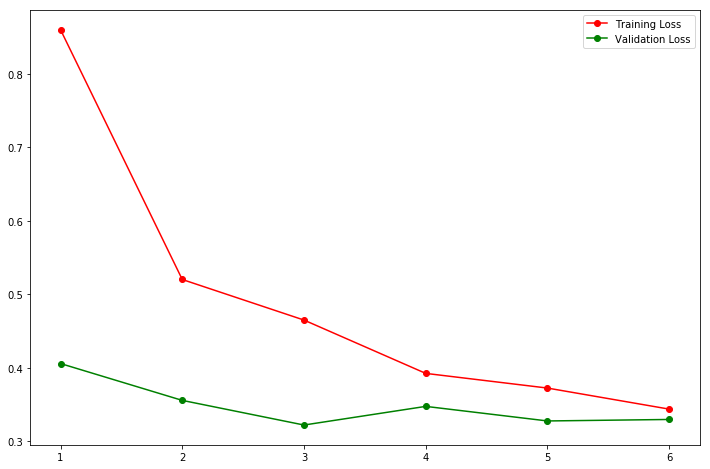

In [ ]:
plotErrorGraph(history,6)


- Look at the results, Test Loss = 0.2586
- Test Accuracy = 97.43%

##### **Final Model Weights**

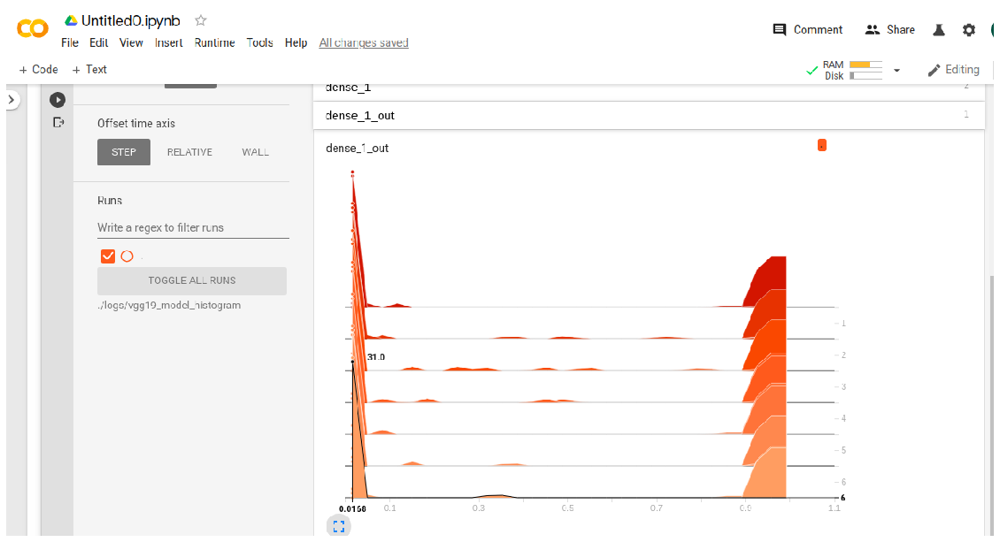

In [23]:

img = PIL.Image.open('/content/drive/My Drive/Memes Detection/result_images/final_model_weights_1.png')

plt.figure(figsize=(20,30))
plt.imshow(img)
plt.axis('off')
plt.show()

## 4. Visualise Output

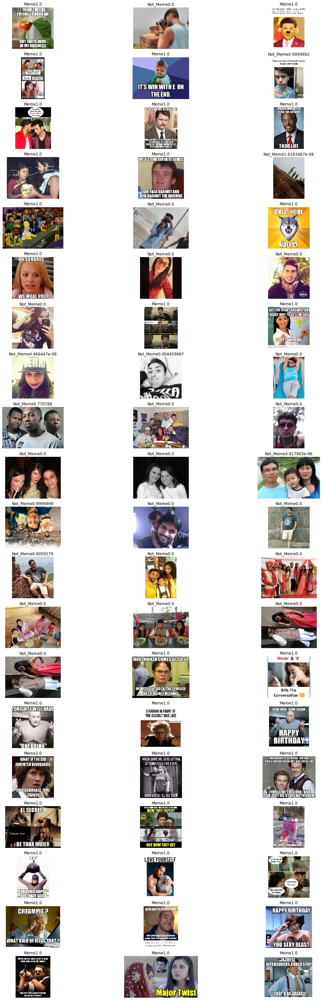

In [ ]:
rows = 25
path= '/content/drive/My Drive/Memes Detection/test_raw'

os.chdir(path)
files=os.listdir(path)


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:

    img_path =os.path.join(path,f)

    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)

    prediction = model.predict(x)
    class_lable =CATEGORIES[int(prediction[0][0])]
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    class_lable = class_lable+ str(prediction[0][0])
    plt.imshow(img)
    plt.title(class_lable)

  except Exception as e:  # in the interest in keeping the output clean...
    pass

  

### Below set is not part of Train set or Validation set or Test set. It is complete different and new images.

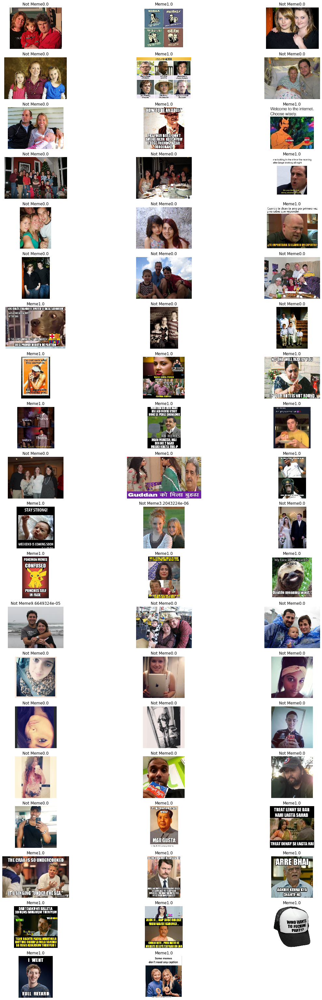

In [ ]:
rows = 25

path= '/content/drive/My Drive/Memes Detection/test_set_2'

os.chdir(path)
files=os.listdir(path)
CATEGORIES = ["Not Meme", "Meme"]


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:

    img_path =os.path.join(path,f)

    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)

    prediction = model.predict(x)
    class_lable =CATEGORIES[int(prediction[0][0])]
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    class_lable = class_lable+ str(prediction[0][0])
    plt.imshow(img)
    plt.title(class_lable)



    # plt.subplot(rows,3,num+1)
    # plt.axis('off')
    # plt.imshow(img)
  except Exception as e:  # in the interest in keeping the output clean...
    print(e)
    pass

  

- We can see that model is able to identify Meme image and not meme images.
-That's brilliant.


## TFlite Model

### Convert TF model to  TFLite Model

In [ ]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

#### Save models

In [ ]:
model.save('/content/drive/My Drive/Meme Detection/vgg19_best_model.v1.h5')
open("/content/drive/My Drive/Meme Detection/vgg19_best_model.v1.tflite", "wb").write(tflite_model)



---



# Part -2

This is part 2 of our case study. Till now we built model which can ideantify memes images and real images.

<br>

Let's deploy model to **Flutter** enviornment.

### **MobileNet**

In [ ]:
keras.backend.clear_session()

In [ ]:

IMG_SIZE =224
image_input = Input(shape=(224, 224, 3))
IMG_SHAPE = (IMG_SIZE, IMG_SIZE, 3)
## mobile net
mobilenet_v1 = tf.keras.applications.mobilenet.MobileNet(include_top=False,
                                            weights='imagenet', input_shape=IMG_SHAPE, pooling=None, classes=1)   

dense_layer1 = tf.keras.layers.Dense(512,activation='relu')  

dense_layer2 = tf.keras.layers.Dense(128,activation='relu') 

prediction_layer = tf.keras.layers.Dense(1,activation='sigmoid')

flatter = tf.keras.layers.Flatten()

drp_layer = tf.keras.layers.Dropout(0.35)

model2 = tf.keras.Sequential([
  mobilenet_v1,
  flatter,
  dense_layer1,
  drp_layer,
  dense_layer2,
  drp_layer,
  prediction_layer
])

for layer in model2.layers:
  print(layer, layer.trainable)
 
model2.summary()

model2.compile(loss='binary_crossentropy',
              # optimizer=tf.keras.optimizers.Adamax(0.0005),
               optimizer='adam',
              metrics=['accuracy'])
earliStop = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=1)

history2 = model2.fit(X_train,
          cat_y_train,
          batch_size=200,
          validation_data=(X_val, cat_y_val),
          callbacks=[earliStop],
          epochs=9) 

<tensorflow.python.keras.engine.training.Model object at 0x7fda773dcdd8> True
<tensorflow.python.keras.layers.core.Flatten object at 0x7fd863779fd0> True
<tensorflow.python.keras.layers.core.Dense object at 0x7fd8661b3c88> True
<tensorflow.python.keras.layers.core.Dropout object at 0x7fd863779c88> True
<tensorflow.python.keras.layers.core.Dense object at 0x7fd864c3ebe0> True
<tensorflow.python.keras.layers.core.Dense object at 0x7fd8637799b0> True
Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenet_1.00_224 (Model)   (None, 7, 7, 1024)        3228864   
_________________________________________________________________
flatten_3 (Flatten)          (None, 50176)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 512)               25690624  
________________________________________________________________

In [ ]:
print(model2.metrics_names)

score = model2.evaluate(X_test, cat_y_test)
score

['loss', 'accuracy']
3356/3356 [==============================] - 3s 847us/sample - loss: 0.3320 - accuracy: 0.9169


[0.33201820083492256, 0.9168653]

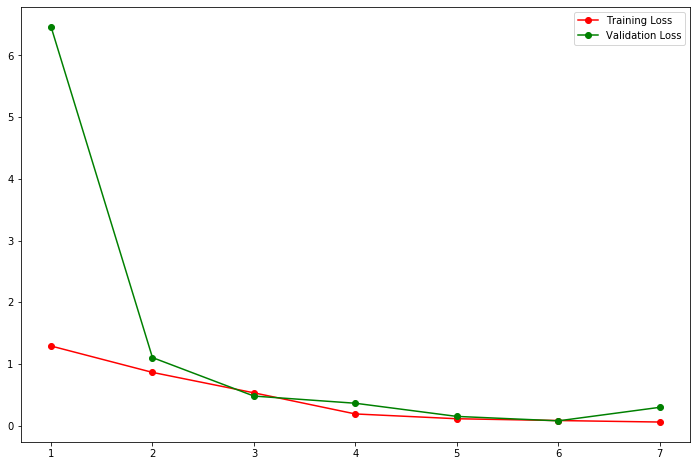

In [ ]:
plotErrorGraph(history2,7)

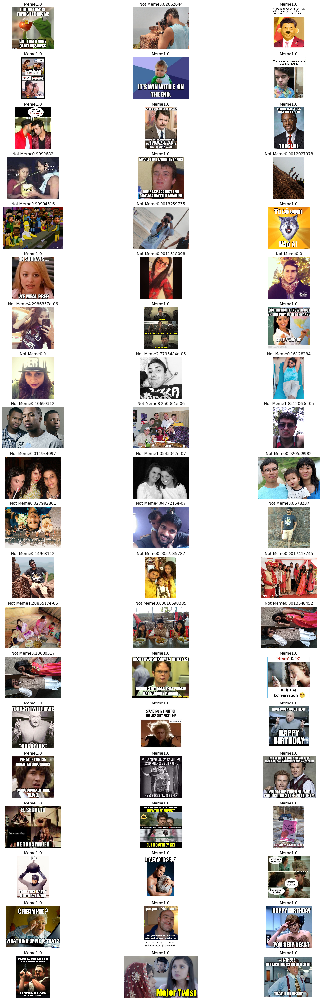

In [ ]:

CATEGORIES = ["Not Meme","Meme"]
rows = 25

path= '/content/drive/My Drive/Memes Detection/test_raw'

os.chdir(path)
files=os.listdir(path)


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:

    img_path =os.path.join(path,f)

    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)


    prediction = model1.predict(x)
    class_lable =CATEGORIES[int(prediction[0][0])]
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    class_lable = class_lable+ str(prediction[0][0])
    plt.imshow(img)
    plt.title(class_lable)

  except Exception as e:  # in the interest in keeping the output clean...
    print(e)
    pass


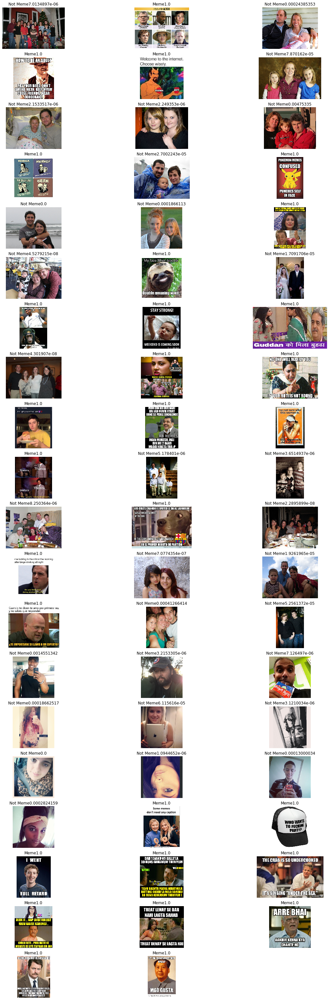

In [ ]:
rows = 25

path= '/content/drive/My Drive/Memes Detection/test_set_2'

os.chdir(path)
files=os.listdir(path)
CATEGORIES = ["Not Meme", "Meme"]


plt.figure(figsize=(20,70))
for num, f in enumerate(files):
  try:

    img_path =os.path.join(path,f)

    img = image.load_img(img_path, target_size=(224, 224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)

    prediction = model1.predict(x)
    class_lable =CATEGORIES[int(prediction[0][0])]
    img = PIL.Image.open(f)
    plt.subplot(rows,3,num+1)
    plt.axis('off')
    class_lable = class_lable+ str(prediction[0][0])
    plt.imshow(img)
    plt.title(class_lable)

  except Exception as e:  # in the interest in keeping the output clean...
    print(e)
    pass



## TFlite Model

In [ ]:
converter=tf.lite.TFLiteConverter.from_keras_model(model1)
tflite_model = converter.convert()

open("/content/drive/My Drive/Memes Detection/mobile_net/model.tflite", "wb").write(tflite_model)

12999356

Below is ImageClassifier.java file.

In [ ]:
package com.example.memedetection;

import android.content.Context;
import android.content.res.AssetFileDescriptor;
import android.graphics.Bitmap;
import android.os.SystemClock;
import android.util.Log;

import org.tensorflow.lite.Interpreter;

import java.io.BufferedReader;
import java.io.FileInputStream;
import java.io.IOException;
import java.io.InputStreamReader;
import java.nio.ByteBuffer;
import java.nio.ByteOrder;
import java.nio.MappedByteBuffer;
import java.nio.channels.FileChannel;
import java.util.AbstractMap;
import java.util.ArrayList;
import java.util.Comparator;
import java.util.List;
import java.util.Map;
import java.util.PriorityQueue;

import static com.example.memedetection.Utils.Constants.IMAGE_STATUS_MEME;
import static com.example.memedetection.Utils.Constants.IMAGE_STATUS_NOT_MEME;

public class MemeClassifier {

    private static volatile MemeClassifier INSTANCE;


    /**
     * Tag for the {@link Log}.
     */
    private static final String TAG = "TfLiteCameraDemo";

    /**
     * Name of the model file stored in Assets.
     */
    private static final String VGG_MODEL_PATH = "vgg_model.v1.tflite";
    private static final String MODEL_PATH = "mobilenet_model.tflite";

    /**
     * Name of the label file stored in Assets.
     */
    private static final String LABEL_PATH = "labels.txt";

    /**
     * Number of results to show in the UI.
     */
    private static final int RESULTS_TO_SHOW = 1;

    /**
     * Dimensions of inputs.
     */
    private static final int DIM_BATCH_SIZE = 1;

    private static final int DIM_PIXEL_SIZE = 3;

    static final int DIM_IMG_SIZE_X = 224;
    static final int DIM_IMG_SIZE_Y = 224;

    private static final int IMAGE_MEAN = 128;
    private static final float IMAGE_STD = 128.0f;


    /* Preallocated buffers for storing image data in. */
    private int[] intValues = new int[DIM_IMG_SIZE_X * DIM_IMG_SIZE_Y];

    /**
     * An instance of the driver class to run model inference with Tensorflow Lite.
     */
    private Interpreter tflite;

    /**
     * Labels corresponding to the output of the vision model.
     */
    private List<String> labelList;

    /**
     * A ByteBuffer to hold image data, to be feed into Tensorflow Lite as inputs.
     */
    private ByteBuffer imgData = null;

    /**
     * An array to hold inference results, to be feed into Tensorflow Lite as outputs.
     */
    private float[][] labelProbArray = null;
    /**
     * multi-stage low pass filter
     **/
    private float[][] filterLabelProbArray = null;
    private static final int FILTER_STAGES = 3;
    private static final float FILTER_FACTOR = 0.4f;

    private PriorityQueue<Map.Entry<String, Float>> sortedLabels =
            new PriorityQueue<>(
                    RESULTS_TO_SHOW,
                    new Comparator<Map.Entry<String, Float>>() {
                        @Override
                        public int compare(Map.Entry<String, Float> o1, Map.Entry<String, Float> o2) {
                            return (o1.getValue()).compareTo(o2.getValue());
                        }
                    });


    /**
     * Initializes an {@code ImageClassifier}.
     */
    private MemeClassifier(Context activity) throws IOException {


        tflite = new Interpreter(loadModelFile(activity));
        labelList = loadLabelList(activity);
        imgData =
                ByteBuffer.allocateDirect(
                        4 * DIM_BATCH_SIZE * DIM_IMG_SIZE_X * DIM_IMG_SIZE_Y * DIM_PIXEL_SIZE);
        imgData.order(ByteOrder.nativeOrder());
        labelProbArray = new float[1][labelList.size()];
        filterLabelProbArray = new float[FILTER_STAGES][labelList.size()];
        Log.d(TAG, "Created a Tensorflow Lite Image Classifier.");


    }


    public static MemeClassifier getInstance(Context context) {

        if (INSTANCE == null) {
            try {
                INSTANCE = new MemeClassifier(context);
            } catch (IOException e) {
                e.printStackTrace();
            }
        }

        return INSTANCE;
    }

    /**
     * Classifies a frame from the preview stream.
     */


    /**
     * Classifies a frame from the preview stream.
     */
    public String classifyFrame(Bitmap bitmap) {
        if (tflite == null) {
            Log.e(TAG, "Image classifier has not been initialized; Skipped.");
            return "Uninitialized Classifier.";
        }
        convertBitmapToByteBuffer(bitmap);
        // Here's where the magic happens!!!
        long startTime = SystemClock.uptimeMillis();
        tflite.run(imgData, labelProbArray);
        long endTime = SystemClock.uptimeMillis();
        Log.d(TAG, "Timecost to run model inference: " + Long.toString(endTime - startTime));

        float findProba0 = labelProbArray[0][0];
        float findProba1 = labelProbArray[0][1];

        Log.e("Meme-Detector class", "findProba0 : " + findProba0);
        Log.e("Meme-Detector class", "findProba1 : " + findProba1);

        String result;

        if (findProba1 < findProba0) {
            result = IMAGE_STATUS_MEME;
        } else {
            result = IMAGE_STATUS_NOT_MEME;
        }

        return result;
    }


    /**
     * Closes tflite to release resources.
     */
    public void close() {
        tflite.close();
        tflite = null;

        if (INSTANCE != null) {
            INSTANCE = null;
        }
    }

    /**
     * Reads label list from Assets.
     */
    private List<String> loadLabelList(Context activity) throws IOException {
        List<String> labelList = new ArrayList<String>();
        BufferedReader reader =
                new BufferedReader(new InputStreamReader(activity.getAssets().open(LABEL_PATH)));
        String line;
        while ((line = reader.readLine()) != null) {
            labelList.add(line);
        }
        reader.close();
        return labelList;
    }

    /**
     * Memory-map the model file in Assets.
     */
    private MappedByteBuffer loadModelFile(Context activity) throws IOException {
        AssetFileDescriptor fileDescriptor = activity.getAssets().openFd(MODEL_PATH);
        FileInputStream inputStream = new FileInputStream(fileDescriptor.getFileDescriptor());
        FileChannel fileChannel = inputStream.getChannel();
        long startOffset = fileDescriptor.getStartOffset();
        long declaredLength = fileDescriptor.getDeclaredLength();
        return fileChannel.map(FileChannel.MapMode.READ_ONLY, startOffset, declaredLength);
    }

    /**
     * Writes Image data into a {@code ByteBuffer}.
     */
    private void convertBitmapToByteBuffer(Bitmap bitmap) {
        if (imgData == null) {
            return;
        }
        imgData.rewind();
        bitmap.getPixels(intValues, 0, bitmap.getWidth(), 0, 0, bitmap.getWidth(), bitmap.getHeight());
        // Convert the image to floating point.
        int pixel = 0;
        long startTime = SystemClock.uptimeMillis();
        for (int i = 0; i < DIM_IMG_SIZE_X; ++i) {
            for (int j = 0; j < DIM_IMG_SIZE_Y; ++j) {
                final int val = intValues[pixel++];
                imgData.putFloat((((val >> 16) & 0xFF) - IMAGE_MEAN) / IMAGE_STD);
                imgData.putFloat((((val >> 8) & 0xFF) - IMAGE_MEAN) / IMAGE_STD);
                imgData.putFloat((((val) & 0xFF) - IMAGE_MEAN) / IMAGE_STD);
            }
        }
        long endTime = SystemClock.uptimeMillis();
        Log.d(TAG, "Timecost to put values into ByteBuffer: " + Long.toString(endTime - startTime));
    }

}


# **Part -3**

Deploy model on Google Cloud Platform. We already have deployed model on Flutter enviornment, Let's create a **REST api using Flask**.

## Flask

Below is app.py file

In [ ]:
import os
from PIL import Image
import numpy as np
import io

import urllib.request
import flask
from flask import Flask, request, redirect, jsonify
from werkzeug.utils import secure_filename
from os import makedirs
from os.path import exists, join

import keras as keras_lib
import tensorflow
from tensorflow import Graph, keras
from tensorflow.keras import backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications.imagenet_utils import preprocess_input
from tensorflow.python.keras.models import load_model

print("Tensorflow Version ",tensorflow.__version__)
print("Tensorflow Keras version ",tensorflow.keras.__version__)
print("Keras Version ",keras_lib.__version__)

K.clear_session()
tensorflow.keras.backend.clear_session()

## Initialise Flask
app = flask.Flask(__name__)

@app.before_first_request
def load_model_keras_model():
    global model
    model = load_model('/home/pranay/Image Upload/model.v1.h5')
    print("=============================Model Loaded==========================")


# Maximum Image Uploading size
app.config['MAX_CONTENT_LENGTH'] = 2 * 1024 * 1024

# Image extension allowed
ALLOWED_EXTENSIONS = set(['png', 'jpg', 'jpeg', 'gif'])

def allowed_file(filename):
    return '.' in filename and filename.rsplit('.', 1)[1].lower() in ALLOWED_EXTENSIONS


print("Loading keras model")
load_model_keras_model()


## ping server request
@app.route('/pingserver',methods=['GET'])
def pingServer():

    pingResp = {'response_message': "Pong from server", 'response_code': "200", "response_root": "Success"}

    return jsonify(pingResp)

## For multiple files upload..
@app.route('/predict', methods=['POST'])
def predict():

    responseFileList = []

    if 'file' not in request.files:
        fileResp = {'response_message': "No file part in the request", 'response_code': "400", "response_root": "Error"}
        responseFileList.append(fileResp)

    uploaded_files = request.files.getlist("file")

    for file in uploaded_files:

        try:

            if file.filename == '':
                fileResp = {'response_message': "No file part in the request", 'response_code': "400",
                            "response_root": "Error"}
                fileResp = {'file': filename}
                responseFileList.append(fileResp)

            # Check if the file is one of the allowed types/extensions
            elif file and allowed_file(file.filename):
                filename = secure_filename(file.filename)

                class_lable = predict_label(file)

                if (class_lable == ''):

                    fileResp = {'response_message': "Something went wrong", 'response_code': "500",
                                "response_root": "Error", 'imagePath': filename, 'memeStatus': "Not Defined"}
                    responseFileList.append(fileResp)
                else:
                    fileResp = {'response_message': "Valid File", 'response_code': "200",
                                "response_root": "Success", 'imagePath': filename, 'memeStatus': class_lable}
                    responseFileList.append(fileResp)

            else:
                fileResp = {'response_message': "incompatible file extension part in the request",
                            'response_code': "400",
                            "response_root": "Error"}
                responseFileList.append(fileResp)

        except Exception as e:  # in the interest in keeping the output clean...
            filename = secure_filename(file.filename)
            fileResp = {'response_message': "File not uploaded", 'response_code': "500",
                        "response_root": "Error", 'file': filename}
            responseFileList.append(fileResp)
            print(e)
        pass

    return jsonify(responseFileList)




######################################################

def predict_label(f):

    CATEGORIES = ['Not Meme', 'Meme']
    class_lable = ''

    try:
        img = image.load_img(f, target_size=(224, 224))
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)

        prediction = model.predict(x)
        class_lable = CATEGORIES[int(prediction[0][0])]
    except Exception as e:
        pass
        print("Exception---->", e)

    return class_lable


if __name__ == "__main__":
    print(("* Loading Keras model and Flask starting server..."
           "please wait until server has fully started"))
    app.run(host='192.168.43.10', port=5001, debug=True, threaded=True)




Using above code we can deploy model on server with REST API.

Any one can Call 'http://192.168.43.10:5001/predict' REST API.

<br>

Which can have below respone for **Not-Meme**,
<br>

[
    {
        "imagePath": "pHvoWiLkDxjkbck-800x450-noPad.jpg",
        "memeStatus": "Not_Meme",
        "response_code": "200",
        "response_message": "Valid file",
        "response_root": "Success"
    }
]

<br>

And for **Meme** it can have below result. 

<br>

[
    {
        "imagePath": "3gknn7.jpg",
        "memeStatus": "Meme",
        "response_code": "200",
        "response_message": "Valid File",
        "response_root": "Success"
    }
]

**Below are error response**
<br>
1.
<br>

[
    {
        "response_code": "400",
        "response_message": "No file part in the request",
        "response_root": "Error"
    }
]

<br>

2.
<br>

[
    {
        "response_code": "400",
        "response_message": "incompatible file extension part in the request",
        "response_root": "Error"
    }
]

